Copyright 2025 Marc Kamionkowski and Kris Sigurdson.
Licensed under Apache-2.0 (http://www.apache.org/licenses/LICENSE-2.0).

This notebook provides some simple python scripts to make plots and movies from the output of NSphere-SIDM.  

The scripts use data produced by `nsphere --sidm --ntimesteps 12500000 --dtwrite 25000 --nout 250 --tfinal 1100 --sort 3` (the parameters used for the plots in the paper). This is then run with 100000 particles, the default halo profile, an NFW profile with scale radius $r_s = 1.18$ kpc, mass $= 1.15 \times 10^{-9}$ M$_\odot$, and a large-radius cutoff function $[1+(r/r_{\text{vir}})^{10}]^{-1}$ with $r_{\text{vir}} = 19$ (concentration parameter). The SIDM cross section (per unit mass) is isotropic and velocity-independent, and taken to be 50 cm$^2$/g. All of these can be changed using command line options, run `nsphere --help` for more information.

The jupyter notebook is set up to be run from the NSphere-SIDM directory. It was run with Python 3.12.4

## SIDM Core Collapse Analysis, Visualization and Plots

In [1]:
# Import necessary libraries
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from scipy.ndimage import gaussian_filter  # 2D smoothing filter
from IPython.display import HTML
from matplotlib.colors import PowerNorm
import os

# Define the path to the data files and the time steps
# Adjust the path to your data files as necessary

path_template = "../data/Rank_Mass_Rad_VRad_unsorted_t00{timestep:03d}_100000_12500001_1100.dat"
time_steps = range(0, 501, 2)  # Time steps (251 snapshots from 0 to 500)

# Convert time steps to actual time in Gyr
time_in_gyr = [19.605 * t / 500 for t in time_steps]

# Define bin edges for radius (R) and radial velocity (Vrad)
# Fine-tuned for optimal resolution while staying under 20MB limit
bin_edges_R = np.arange(0, 10, 10/154)      # 154 bins
bin_edges_V = np.arange(-50, 50, 100/154)   # 154 bins

print(f"Using {len(bin_edges_R)-1} x {len(bin_edges_V)-1} bins")

# Define the record dtype (as in your original code)
record_dtype = np.dtype([
    ('rank',  np.int32),
    ('mass',  np.float32),
    ('R',     np.float32),
    ('Vrad',  np.float32),
    ('PsiA',  np.float32),
    ('E',     np.float32),
    ('L',     np.float32)
])

# Storage for 2D histograms
all_histograms = []

# Loop over time steps and process each file
for time_step in time_steps:
    file_path = path_template.format(timestep=time_step)
    try:
        # Read the binary file
        alldata = np.fromfile(file_path, dtype=record_dtype)
        # Extract radius and radial velocity data
        data_R = alldata['R']
        data_Vrad = alldata['Vrad']/1.023e-3  # Convert to km/s
        
        if np.isnan(data_R).any() or np.isnan(data_Vrad).any():
            print(f"Warning: NaN values found in file at time step {time_step}")
        if not (np.isfinite(data_R).all() and np.isfinite(data_Vrad).all()):
            print(f"Warning: Non-finite values found in file at time step {time_step}")
        
        # Compute 2D histogram: counts for each (R, Vrad) bin
        hist, _, _ = np.histogram2d(data_R, data_Vrad, bins=[bin_edges_R, bin_edges_V])
        
        # Optionally, apply 2D Gaussian smoothing
        # Adjust sigma=(sigma_R, sigma_V) as appropriate
        smoothed_hist = gaussian_filter(hist, sigma=(0.1, 0.1))
        
        # Optionally, you could apply a normalization/scaling here if desired
        
        all_histograms.append(smoothed_hist)
    except Exception as e:
        print(f"Error reading file {file_path}: {e}")
        # Append a zero histogram if file is missing or cannot be read
        all_histograms.append(np.zeros((len(bin_edges_R)-1, len(bin_edges_V)-1)))

# Convert list to numpy array for easier handling
all_histograms = np.array(all_histograms)
print("Histogram data shape:", all_histograms.shape)  # (time_steps, n_R_bins, n_V_bins)

# Determine common color scale for the animation
vmin = 0
vmax = np.max(all_histograms)  # Use data maximum across all frames

# Create the animation with power-law color scaling
fig, ax = plt.subplots(figsize=(8, 6))
# Note: We transpose the histogram so that the horizontal axis corresponds to R and vertical to Vrad.
# Use PowerNorm with gamma=1/4 for x^(1/4) scaling
# Use 'hot' colormap for better distinction of high-density regions (black->red->yellow->white)
im = ax.imshow(all_histograms[0].T, origin='lower',
               extent=[bin_edges_R[0], bin_edges_R[-1], bin_edges_V[0], bin_edges_V[-1]],
               aspect='auto', cmap='viridis', norm=PowerNorm(gamma=3/4, vmin=vmin, vmax=vmax))

ax.set_xlabel(r"$r\;\;$[$\mathrm{kpc}$]")
ax.set_ylabel(r"$v_r\;\;$[$\mathrm{km}/\mathrm{s}$]")
ax.set_title(r"$t = %.2f\;\;$[$\mathrm{Gyr}$]" % time_in_gyr[0])
fig.colorbar(im, ax=ax, label=r"Counts per bin")

def update(frame):
    im.set_data(all_histograms[frame].T)  # update image data
    ax.set_title(r"$t = %.2f\;\;$[$\mathrm{Gyr}$]" % time_in_gyr[frame])
    return im,

ani = FuncAnimation(fig, update, frames=len(time_steps), repeat=True, interval=200, blit=True)

# Uncomment to show initial static image
# plt.show()

# Uncomment this line to save the animation as a GIF
# ani.save("results/phasespace.gif", writer="pillow", fps=10)

# Close the figure to prevent static display
plt.close(fig)

# For displaying in a Jupyter Notebook:
HTML(ani.to_jshtml())

Using 154 x 153 bins
Histogram data shape: (251, 154, 153)


In [2]:
### SECOND ANIMATION: CORE REGION DURING LATE EVOLUTION (12.4-16.4 Gyr)

# Import necessary libraries (if not already imported)
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from scipy.ndimage import gaussian_filter
from IPython.display import HTML
from matplotlib.colors import PowerNorm

# Define focused ranges for core region analysis with square bin grid
core_bin_edges_R = np.arange(0, 0.5, 0.5/30)     # 30 bins from 0 to 0.5 kpc (0.0167 kpc per bin)
core_bin_edges_V = np.arange(-30, 30, 60/30)     # 30 bins from -30 to +30 km/s (2.0 km/s per bin)

print(f"Core region using {len(core_bin_edges_R)-1} x {len(core_bin_edges_V)-1} bins")

# Select time range from 12.4 to 16.4 Gyr to focus on peak core collapse phase
# time_in_gyr = 19.605 * t / 500, so for 12.4 Gyr: t ≈ 316, for 16.4 Gyr: t ≈ 418
# Since time_steps = range(0, 501, 2), we need frame indices:
start_frame_idx = 158  # corresponds to time_step 316 (12.4 Gyr)
end_frame_idx = 209    # corresponds to time_step 418 (16.4 Gyr)

core_time_steps = list(range(start_frame_idx, end_frame_idx + 1))
core_time_in_gyr = [time_in_gyr[i] for i in core_time_steps]

print(f"Time range: {core_time_in_gyr[0]:.1f} to {core_time_in_gyr[-1]:.1f} Gyr ({len(core_time_steps)} frames)")

# Storage for core region 2D histograms (30x30 bins for balanced resolution)
core_histograms = []

# Process the selected time range focusing on peak core collapse period
for frame_idx in core_time_steps:
    time_step = time_steps[frame_idx]
    file_path = path_template.format(timestep=time_step)
    
    try:
        # Read the binary file
        alldata = np.fromfile(file_path, dtype=record_dtype)
        # Extract radius and radial velocity data
        data_R = alldata['R']
        data_Vrad = alldata['Vrad']/1.023e-3  # Convert to km/s
        
        # Filter data to core region (r ≤ 0.5 kpc, |v_r| ≤ 30 km/s)
        core_mask = (data_R <= 0.5) & (data_Vrad >= -30) & (data_Vrad <= 30)
        core_R = data_R[core_mask]
        core_Vrad = data_Vrad[core_mask]
        
        # Compute 2D histogram for core region with square bin grid
        hist, _, _ = np.histogram2d(core_R, core_Vrad, bins=[core_bin_edges_R, core_bin_edges_V])
        
        # Apply 2D Gaussian smoothing for noise reduction
        smoothed_hist = gaussian_filter(hist, sigma=(0.5, 0.5))
        
        core_histograms.append(smoothed_hist)
        
    except Exception as e:
        print(f"Error reading file {file_path}: {e}")
        # Append a zero histogram if file is missing or cannot be read
        core_histograms.append(np.zeros((len(core_bin_edges_R)-1, len(core_bin_edges_V)-1)))

# Convert to numpy array for efficient processing
core_histograms = np.array(core_histograms)
print("Core histogram data shape:", core_histograms.shape)  # (52 frames, 30 R-bins, 30 V-bins)

# Determine color scale for core animation using data maximum across all frames
core_vmin = 0
core_vmax = np.max(core_histograms)

# Create the core region animation with square bin grid
fig_core, ax_core = plt.subplots(figsize=(8, 6))

# Initial plot for core region (12.4-16.4 Gyr evolution)
im_core = ax_core.imshow(core_histograms[0].T, origin='lower',
                        extent=[core_bin_edges_R[0], core_bin_edges_R[-1], 
                               core_bin_edges_V[0], core_bin_edges_V[-1]],
                        aspect='auto', cmap='hot', 
                        norm=PowerNorm(gamma=5/3, vmin=core_vmin, vmax=core_vmax))

ax_core.set_xlabel(r"$r\;\;$[$\mathrm{kpc}$]")
ax_core.set_ylabel(r"$v_r\;\;$[$\mathrm{km}/\mathrm{s}$]")
ax_core.set_title(r"Core Region: $t = %.1f\;\;$[$\mathrm{Gyr}$]" % core_time_in_gyr[0])
fig_core.colorbar(im_core, ax=ax_core, label=r"Counts per bin")

def update_core(frame):
    im_core.set_data(core_histograms[frame].T)
    ax_core.set_title(r"Core Region: $t = %.1f\;\;$[$\mathrm{Gyr}$]" % core_time_in_gyr[frame])
    return im_core,

# Create animation with 15fps for smooth viewing of peak core collapse
ani_core = FuncAnimation(fig_core, update_core, frames=len(core_time_steps), 
                        repeat=True, interval=66.67, blit=True)  # 66.67ms -> 15fps

# Uncomment to show initial static image
# plt.show()

# Close the figure to prevent static display
plt.close(fig_core)

# Display the core animation focusing on 12.4-16.4 Gyr peak collapse period
HTML(ani_core.to_jshtml())

Core region using 29 x 29 bins
Time range: 12.4 to 16.4 Gyr (52 frames)
Core histogram data shape: (52, 29, 29)


In [3]:
######  THIS CELL MAKES AN ANIMATION OF THE EVOLUTION OF THE RADIAL NUMBER DISTRIBUTION


import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from scipy.ndimage import gaussian_filter1d
from IPython.display import HTML


bin_edges = np.arange(0, 10, 0.02)  # Bin edges for radii between 0 and 10
bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2  # Calculate bin centers

# Storage for smoothed histograms
all_smoothed_counts = []

record_dtype = np.dtype([
    ('rank',  np.int32),
    ('mass',  np.float32),
    ('R',     np.float32),
    ('Vrad',  np.float32),
    ('PsiA',  np.float32),
    ('E',     np.float32),
    ('L',     np.float32)
])

# Process each file
for time_step in time_steps:
    file_path = path_template.format(timestep=time_step)
    try:
        # Read the first column (radii)
        alldata = np.fromfile(file_path, dtype=record_dtype)
        data = alldata['R']

        if np.isnan(data).any():
            print(f"Warning: NaN values found in data at Time Step: {time_step}")
        if not np.isfinite(data).all():
            print(f"Warning: Infinite values found in data at Time Step: {time_step}")
        
        # Count particles in bins
        counts, _ = np.histogram(data, bins=bin_edges)
        # Smooth the counts using a Gaussian filter
        smoothed_counts = gaussian_filter1d(counts, sigma=1)
        all_smoothed_counts.append(smoothed_counts)
    except Exception as e:
        print(f"Error reading file {file_path}: {e}")
        all_smoothed_counts.append(np.zeros(len(bin_centers)))  # Append zeros if file is missing

# Convert to numpy array for easier handling
all_smoothed_counts = np.array(all_smoothed_counts)

# Create animation
fig, ax = plt.subplots()
line, = ax.plot(bin_centers, all_smoothed_counts[0], color="blue")


ax.set_xlim(0, 10)      # Lower limit is > 0
ax.set_ylim(0, 500)     # Lower limit is > 0

ax.set_xlabel(r"$r\;\;$[$\mathrm{kpc}$]")
ax.set_ylabel(r"$N\;\;$[particles per bin]")
ax.set_title(r"$N(r)$ at $t = %.2f\;\;$[$\mathrm{Gyr}$]" % time_in_gyr[0])

def update(frame):
    line.set_ydata(all_smoothed_counts[frame])  # Update the y-data for the line
    ax.set_title(r"$N(r)$ at $t = %.2f\;\;$[$\mathrm{Gyr}$]" % time_in_gyr[frame])
    return line,

ani = FuncAnimation(fig, update, frames=len(time_steps), repeat=True, interval=200)

# Uncomment to show initial static image
# plt.show()

# Uncomment this line to save the animation as a GIF
# ani.save("results/number.gif", writer="pillow", fps=10)

# Close the figure to prevent static display
plt.close(fig)

HTML(ani.to_jshtml())

Processing files...
Finished processing. Processed data for 251 time steps.
Generating and saving plots...


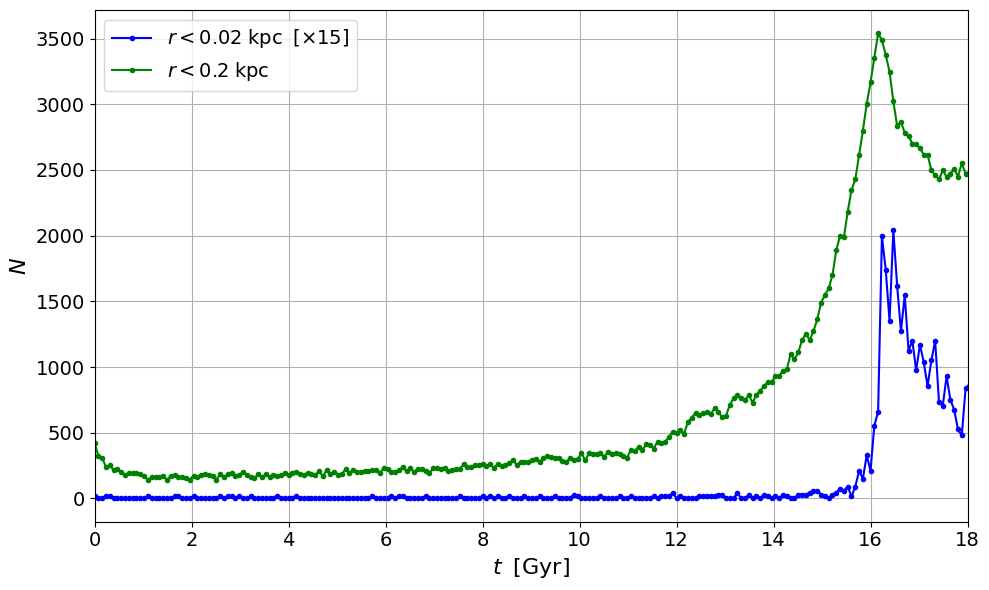

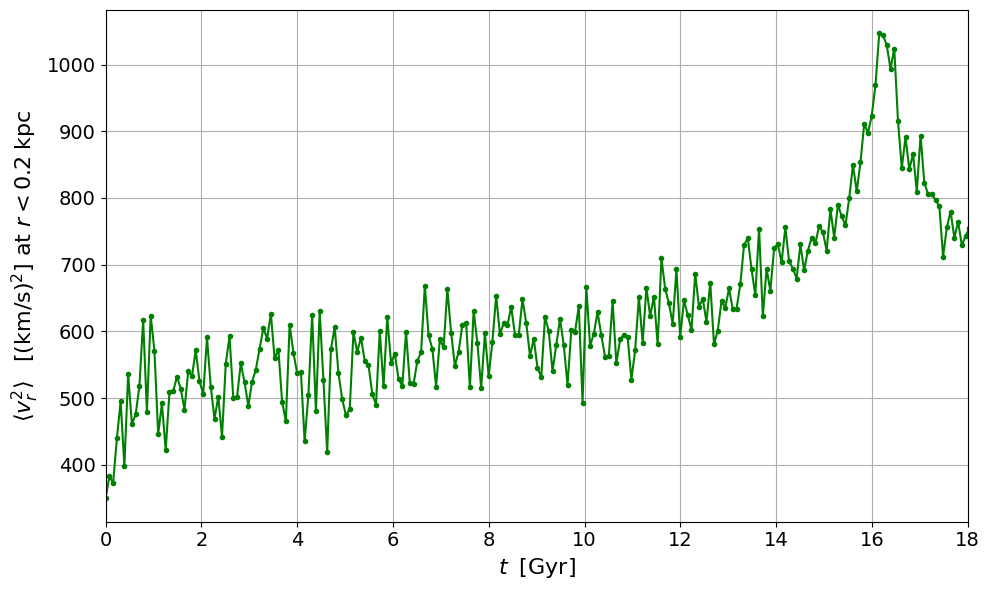

In [4]:
##  THIS CELL PLOTS THE EVOLUTION OF THE PARTICLE NUMBER AND MEAN SQUARE VELOCITY IN THE LOWEST RADIUS BINS

## Uncomment the "plt.savefig" lines to save the plots as PDF files

# Import necessary libraries
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from scipy.ndimage import gaussian_filter1d
import os

# --- Configuration ---

bin_edges = np.arange(0, 2, 0.02)  # Bin edges for radii
smoothing_sigma = 0.001 # Sigma for Gaussian smoothing of counts
num_lowest_bins_to_sum = 10 # How many lowest bins for summed count and MSV plots

# Check if base data directory exists
if not os.path.exists(os.path.dirname(path_template)):
     print(f"Warning: Base directory {os.path.dirname(path_template)} does not exist. Please check the path.")

# Calculate bin centers and prepare labels
bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2
if len(bin_centers) < num_lowest_bins_to_sum:
    raise ValueError(f"Requested sum/MSV of {num_lowest_bins_to_sum} bins, but only {len(bin_centers)} bins are defined.")

lowest_bin_range_str = f"[{bin_edges[0]}, {bin_edges[1]})"
sum_bins_range_str = f"[{bin_edges[0]}, {bin_edges[num_lowest_bins_to_sum]})"

# --- Storage ---
all_smoothed_counts = []
lowest_bin_counts = []        # Smoothed count in bin 1
sum_lowest_n_bins_counts = [] # Smoothed count sum in bins 1 to N
msv_bin1_list = []            # Mean Square Velocity in bin 1
msv_bins1_n_list = []         # Mean Square Velocity in bins 1 to N
actual_time_steps = []      # Time steps with successfully processed data

record_dtype = np.dtype([
    ('rank',  np.int32),
    ('mass',  np.float32),
    ('R',     np.float32), # Radius
    ('Vrad',  np.float32), # Radial Velocity
    ('PsiA',  np.float32),
    ('E',     np.float32),
    ('L',     np.float32)
])

# --- Process each file ---
print("Processing files...")
for time_step in time_steps:
    file_path = path_template.format(timestep=time_step)
    try:
        if not os.path.exists(file_path):
            print(f"File not found: {file_path}, skipping time step {time_step}")
            continue

        alldata = np.fromfile(file_path, dtype=record_dtype)
        if alldata.size == 0:
             print(f"Warning: File is empty {file_path}, skipping time step {time_step}")
             continue

        # Extract Radius and Radial Velocity
        radii = alldata['R']
        vrad = alldata['Vrad']

        # Check for NaNs/Infs in essential data
        # Note: np.histogram handles NaNs in input, but mean calculation doesn't easily
        valid_data_mask = np.isfinite(radii) & np.isfinite(vrad)
        if not np.all(valid_data_mask):
             print(f"Warning: Non-finite R or Vrad values found at Time Step: {time_step}. Filtering them out for calculations.")
             radii = radii[valid_data_mask]
             vrad = vrad[valid_data_mask]
             if radii.size == 0:
                 print(f"Warning: No finite data remaining after filtering at Time Step: {time_step}. Skipping step.")
                 continue # Skip if no valid data left

        # 1. Histogram and Smoothed Counts
        counts, _ = np.histogram(radii, bins=bin_edges)
        smoothed_counts = gaussian_filter1d(counts, sigma=smoothing_sigma)

        # Store count data
        all_smoothed_counts.append(smoothed_counts)
        lowest_bin_counts.append(smoothed_counts[0])
        sum_n_bins = np.sum(smoothed_counts[0:num_lowest_bins_to_sum])
        sum_lowest_n_bins_counts.append(sum_n_bins)

        # 2. Mean Square Velocity Calculations
        # Digitize particles into bins. `digitize` returns index i if bin_edges[i-1] <= x < bin_edges[i]
        # So, index 1 corresponds to the first bin [bin_edges[0], bin_edges[1])
        bin_indices = np.digitize(radii, bin_edges, right=False)

        # MSV for the first bin (index == 1)
        mask_bin1 = (bin_indices == 1)
        vrad_bin1 = vrad[mask_bin1]
        if vrad_bin1.size > 0:
            msv_bin1 = np.mean(vrad_bin1**2)
        else:
            msv_bin1 = np.nan # Use NaN if bin is empty

        # MSV for the first N bins (index between 1 and N, inclusive)
        mask_bins1_n = (bin_indices >= 1) & (bin_indices <= num_lowest_bins_to_sum)
        vrad_bins1_n = vrad[mask_bins1_n]
        if vrad_bins1_n.size > 0:
            msv_bins1_n = 3.0 * np.mean(vrad_bins1_n**2)/1.023e-3**2 # Convert to (km/s)^2
        else:
            msv_bins1_n = np.nan # Use NaN if bins are empty

        msv_bin1_list.append(msv_bin1)
        msv_bins1_n_list.append(msv_bins1_n)

        # If all calculations successful, record the time step
        actual_time_steps.append(time_step)

    except Exception as e:
        print(f"Error reading or processing file {file_path}: {e}")
        # Remove potentially partially added data for this step if error occurred mid-processing
        if len(actual_time_steps) < len(lowest_bin_counts): lowest_bin_counts.pop()
        if len(actual_time_steps) < len(sum_lowest_n_bins_counts): sum_lowest_n_bins_counts.pop()
        if len(actual_time_steps) < len(msv_bin1_list): msv_bin1_list.pop()
        if len(actual_time_steps) < len(msv_bins1_n_list): msv_bins1_n_list.pop()
        if len(actual_time_steps) < len(all_smoothed_counts): all_smoothed_counts.pop()


print(f"Finished processing. Processed data for {len(actual_time_steps)} time steps.")

# --- Generate and Save Static Plots ---
actual_time_steps1 = 19.605 /500 * np.array(actual_time_steps)  # for 500 time steps

if actual_time_steps: # Proceed only if some data was processed
    print("Generating and saving plots...")

    lowest_bin_counts = np.array(lowest_bin_counts)

    # Plot 1: Lowest Bin Count Evolution
    fig1, ax1 = plt.subplots(figsize=(10, 6))
    ax1.plot(actual_time_steps1, 15*lowest_bin_counts, marker='.', linestyle='-', color='blue', label = r'$r<0.02\;\mathrm{kpc}\;\;$[$\times 15$]')
    ax1.plot(actual_time_steps1, sum_lowest_n_bins_counts, marker='.', linestyle='-', color='green',label = r'$r<0.2\;\mathrm{kpc}$')
    ax1.set_xlabel(r"$t\;\;$[$\mathrm{Gyr}$]", fontsize=16)
    ax1.set_ylabel(r"$N$", fontsize=16)
    ax1.legend(fontsize=14,loc='best')
    ax1.set_xlim(0, 18)  # Set x-axis limit to 0-18 Gyr
    plt.tick_params(axis='both', which='major', labelsize=14)  # Change font size for major ticks
    plt.tick_params(axis='both', which='minor', labelsize=10)  # Change font size for minor ticks   
    ax1.grid(True)
    plt.tight_layout()
    plt.savefig("fig2_particle_count_evolution.pdf")

    # Plot 2: Mean Square Velocity in Lowest N Bins
    fig4, ax4 = plt.subplots(figsize=(10, 6))
    ax4.plot(actual_time_steps1, msv_bins1_n_list, marker='.', linestyle='-', color='green')
    ax4.set_xlabel(r"$t\;\;$[$\mathrm{Gyr}$]", fontsize=16)
    ax4.set_ylabel(r'$\langle v_r^2 \rangle\;\;\;$[$(\mathrm{km}/\mathrm{s})^2$] at $r<0.2\;\mathrm{kpc}$', fontsize=16)
    plt.tick_params(axis='both', which='major', labelsize=14)  # Change font size for major ticks
    plt.tick_params(axis='both', which='minor', labelsize=10)  # Change font size for minor ticks
    ax4.grid(True)
    ax4.set_xlim(0, 18)  # Set x-axis limit to 0-18 Gyr
    plt.tight_layout()
    plt.savefig("fig3_radial_velocity_dispersion.pdf")

else:
    print("No data was successfully processed. Cannot generate plots.")

In [5]:
###  THIS CELL MAKES AN ANIMATION OF THE EVOLUTION OF THE DENSITY DISTRIBUTION


import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from scipy.ndimage import gaussian_filter1d
from IPython.display import HTML
import os

# --- Configuration ---

# == Parameters for Density Animation (Log Bins) ==
density_num_bins = 10 # Number of bins for the density plot
density_min_radius = 0.02
density_max_radius = 2.0
log_bin_edges = np.logspace(np.log10(density_min_radius),
                            np.log10(density_max_radius),
                            density_num_bins + 1)
# Calculate geometric bin centers and linear bin widths for log bins
log_bin_centers = np.sqrt(log_bin_edges[:-1] * log_bin_edges[1:])
log_bin_widths = np.diff(log_bin_edges)

# --- Storage ---
# For density animation
all_densities = []
all_density_errors = []
# Common
actual_time_steps = []

record_dtype = np.dtype([
    ('rank',  np.int32),
    ('mass',  np.float32),
    ('R',     np.float32), # Radius
    ('Vrad',  np.float32), # Radial Velocity
    ('PsiA',  np.float32),
    ('E',     np.float32),
    ('L',     np.float32)
])

# --- Process each file ---
print("Processing files...")
for time_step in time_steps:
    file_path = path_template.format(timestep=time_step)
    try:
        if not os.path.exists(file_path):
            print(f"File not found: {file_path}, skipping time step {time_step}")
            continue

        alldata = np.fromfile(file_path, dtype=record_dtype)
        if alldata.size == 0:
             print(f"Warning: File is empty {file_path}, skipping time step {time_step}")
             continue

        radii = alldata['R']

        # Filter radii specifically for the density plot range
        radii_for_density = radii[(radii >= density_min_radius) & (radii <= density_max_radius)]

        counts_log, _ = np.histogram(radii_for_density, bins=log_bin_edges)

        # Calculate density: N / (4*pi*R^2 * ΔR)
        # Avoid division by zero if counts are zero
        # Use np.divide with where clause for safety, although R^2 and width shouldn't be zero here.
        denominator = 4.0 * np.pi * (log_bin_centers**2) * log_bin_widths
        density = np.divide(counts_log, denominator, out=np.zeros_like(denominator, dtype=float), where=denominator!=0)
        density_errors = np.divide(np.sqrt(counts_log), denominator, out=np.zeros_like(denominator, dtype=float), where=denominator!=0)
        all_densities.append(density)
        all_density_errors.append(density_errors)
        # --- Record successful timestep ---
        actual_time_steps.append(time_step)

    except Exception as e:
        print(f"Error reading or processing file {file_path} at timestep {time_step}: {e}")
        if len(actual_time_steps) < len(all_densities): all_densities.pop()
        if len(actual_time_steps) < len(all_density_errors): all_density_errors.pop()


print(f"Finished processing. Processed data for {len(actual_time_steps)} time steps.")

# Convert actual time steps to time in Gyr
actual_time_in_gyr = [19.605 * t / 500 for t in actual_time_steps]

# Convert density list to numpy array for easier handling
all_densities_np = np.array(all_densities)
all_density_errors_np = np.array(all_density_errors)



# --- Create Density Animation ---
if all_densities_np.size > 0:
    print("Generating density animation...")

    fig_density, ax_density = plt.subplots(figsize=(8, 6))

    # Initial plot using the first frame's data
    ax_density.errorbar(
        log_bin_centers, all_densities_np[0], yerr=all_density_errors_np[0], 
        fmt='o', markersize=3, linestyle='None', color="teal", ecolor="gray", capsize=3
    )

    # Set log scales
    ax_density.set_xscale('log')
    ax_density.set_yscale('log')

    # Set labels and title
    ax_density.set_xlabel(r"$r\;\;$[$\mathrm{kpc}$]")
    ax_density.set_ylabel(r"$N / (4\pi r^2 \Delta r)\;\;$[$\mathrm{kpc}^{-3}$]")
    ax_density.set_title(r"$t = %.2f\;\;$[$\mathrm{Gyr}$]" % actual_time_in_gyr[0])

    # Set fixed limits based on config and calculated density range
    ax_density.set_xlim(density_min_radius, density_max_radius)

    # Determine y-limits dynamically (avoiding zeros for log scale)
    min_density = np.nanmin(all_densities_np[all_densities_np > 0]) if np.any(all_densities_np > 0) else 1e-3
    max_density = np.nanmax(all_densities_np) if np.any(np.isfinite(all_densities_np)) else 1.0
    if max_density <= min_density: # Handle cases with no variance or single point
         max_density = min_density * 10
    ax_density.set_ylim(min_density * 0.5, max_density * 2.0) # Add some padding

    ax_density.grid(True, which="both", ls="--", linewidth=0.5) # Add grid for log-log

    def update_density(frame):
        density_data = all_densities_np[frame]
        density_error_data = all_density_errors_np[frame]
        ax_density.clear() # Clear the axis for redrawing
        #   Re-plot the error bars for the current frame
          # Update title and axis properties
        ax_density.set_xscale('log')
        ax_density.set_yscale('log')
        ax_density.set_title(r"$t = %.2f\;\;$[$\mathrm{Gyr}$]" % actual_time_in_gyr[frame])
        ax_density.set_xlabel(r"$r\;\;$[$\mathrm{kpc}$]")
        ax_density.set_ylabel(r"$N / (4\pi r^2 \Delta r)\;\;$[$\mathrm{kpc}^{-3}$]")
        ax_density.set_xlim(density_min_radius, density_max_radius)
        ax_density.set_ylim(min_density * 0.5, max_density * 2.0)
        ax_density.grid(True, which="both", ls="--", linewidth=0.5)
        errorbar = ax_density.errorbar(
            log_bin_centers, density_data, yerr=density_error_data, 
            fmt='o', markersize=3, linestyle='None', color="teal", ecolor="gray", capsize=3
        )
        return errorbar.get_children() # Return the errorbar artists for blitting


    # Create the animation object
    density_ani = FuncAnimation(fig_density, update_density, frames=len(actual_time_steps),
                                interval=150, blit=True, repeat=True) # blit=True for performance
    
    # Close the figure to prevent static display
    plt.close(fig_density)

# Uncomment to show initial static image
# plt.show()


# Uncomment this line to save the animation as MP4
# density_ani.save("results/loglogdensity.mp4", writer='ffmpeg', fps=15, dpi=150) # Adjust fps/dpi as needed

HTML(density_ani.to_jshtml())

Processing files...
Finished processing. Processed data for 251 time steps.
Generating density animation...


Processing files...
Finished processing. Processed data for 251 time steps.
Generating density animation...


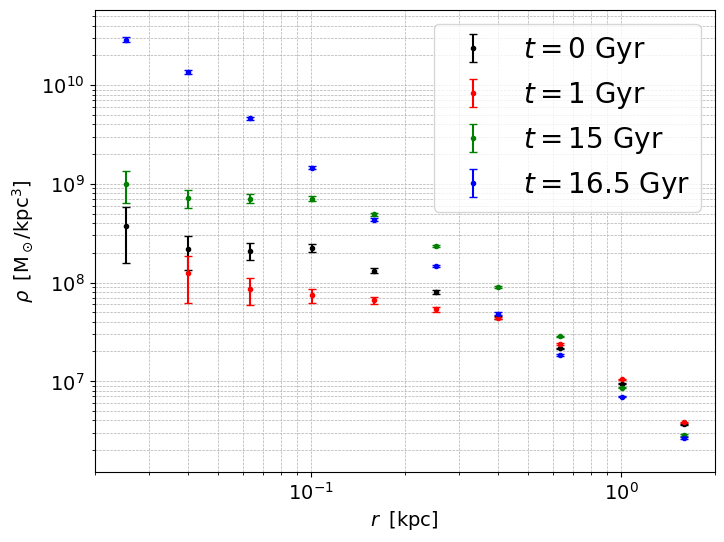

In [6]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from scipy.ndimage import gaussian_filter1d
import os

# --- Configuration ---

density_num_bins = 10 # Number of bins for the density plot
density_min_radius = 0.02
density_max_radius = 2.0
log_bin_edges = np.logspace(np.log10(density_min_radius),
                            np.log10(density_max_radius),
                            density_num_bins + 1)
# Calculate geometric bin centers and linear bin widths for log bins
log_bin_centers = np.sqrt(log_bin_edges[:-1] * log_bin_edges[1:])
log_bin_widths = np.diff(log_bin_edges)


# --- Storage ---
# For original plots
all_smoothed_counts = []
lowest_bin_counts = []
sum_lowest_n_bins_counts = []
msv_bin1_list = []
msv_bins1_n_list = []
# For density animation
all_densities = []
all_density_errors = []
# Common
actual_time_steps = []

record_dtype = np.dtype([
    ('rank',  np.int32),
    ('mass',  np.float32),
    ('R',     np.float32), # Radius
    ('Vrad',  np.float32), # Radial Velocity
    ('PsiA',  np.float32),
    ('E',     np.float32),
    ('L',     np.float32)
])

# --- Process each file ---
print("Processing files...")
for time_step in time_steps:
    file_path = path_template.format(timestep=time_step)
    try:
        if not os.path.exists(file_path):
            print(f"File not found: {file_path}, skipping time step {time_step}")
            continue

        alldata = np.fromfile(file_path, dtype=record_dtype)
        if alldata.size == 0:
             print(f"Warning: File is empty {file_path}, skipping time step {time_step}")
             continue

        radii = alldata['R']
        vrad = alldata['Vrad']

        valid_data_mask = np.isfinite(radii) & np.isfinite(vrad)
        if not np.all(valid_data_mask):
             radii_filt = radii[valid_data_mask]
             vrad_filt = vrad[valid_data_mask]
             radii_orig_for_hist = radii[np.isfinite(radii)] # Keep radii for histogramming even if vrad is bad
             if radii_orig_for_hist.size == 0:
                 print(f"Warning: No finite radii remaining after filtering at Time Step: {time_step}. Skipping step.")
                 continue # Skip if no valid radii left
        else:
             radii_filt = radii
             vrad_filt = vrad
             radii_orig_for_hist = radii

        # --- Calculations for Density Animation (Log Bins) ---
        # Filter radii specifically for the density plot range
        radii_for_density = radii_orig_for_hist[(radii_orig_for_hist >= density_min_radius) & (radii_orig_for_hist <= density_max_radius)]

        counts_log, _ = np.histogram(radii_for_density, bins=log_bin_edges)

        # Calculate density: N / (R^2 * ΔR)
        # Avoid division by zero if counts are zero
        # Use np.divide with where clause for safety, although R^2 and width shouldn't be zero here.
        particlemass = 1.15e4 # Particle mass for conversion to physical units
        denominator = (log_bin_centers**2) * log_bin_widths * 4.0 * np.pi/particlemass
        density = np.divide(counts_log, denominator, out=np.zeros_like(denominator, dtype=float), where=denominator!=0)
        density_errors = np.divide(np.sqrt(counts_log), denominator, out=np.zeros_like(denominator, dtype=float), where=denominator!=0)
        all_densities.append(density)
        all_density_errors.append(density_errors)
        # --- Record successful timestep ---
        actual_time_steps.append(time_step)

    except Exception as e:
        print(f"Error reading or processing file {file_path} at timestep {time_step}: {e}")
        # Attempt to rollback lists if error occurred after some appends
        # This is slightly brittle; ideally, append only at the very end of try block
        if len(actual_time_steps) < len(lowest_bin_counts): lowest_bin_counts.pop()
        if len(actual_time_steps) < len(sum_lowest_n_bins_counts): sum_lowest_n_bins_counts.pop()
        if len(actual_time_steps) < len(msv_bin1_list): msv_bin1_list.pop()
        if len(actual_time_steps) < len(msv_bins1_n_list): msv_bins1_n_list.pop()
        if len(actual_time_steps) < len(all_smoothed_counts): all_smoothed_counts.pop()
        if len(actual_time_steps) < len(all_densities): all_densities.pop()


print(f"Finished processing. Processed data for {len(actual_time_steps)} time steps.")

# Convert density list to numpy array for easier handling
all_densities_np = np.array(all_densities)
all_density_errors_np = np.array(all_density_errors)



# --- Create Density Animation ---
if all_densities_np.size > 0:
    print("Generating density animation...")

    fig_density, ax_density = plt.subplots(figsize=(8, 6))

    # Initial plot using the first frame's data
    ax_density.errorbar(
    log_bin_centers, all_densities_np[0], yerr=all_density_errors_np[0], 
    fmt='o', markersize=3, linestyle='None', color="black", ecolor="black", capsize=3, label=r"$t=0$ $\mathrm{Gyr}$"
)

    ax_density.errorbar(
    log_bin_centers, all_densities_np[12], yerr=all_density_errors_np[12], 
    fmt='o', markersize=3, linestyle='None', color="red", ecolor="red", capsize=3, label =r"$t=1$ $\mathrm{Gyr}$"
)
    
    ax_density.errorbar(
    log_bin_centers, all_densities_np[191], yerr=all_density_errors_np[191], 
    fmt='o', markersize=3, linestyle='None', color="green", ecolor="green", capsize=3, label=r"$t=15$ $\mathrm{Gyr}$"
)
    
    ax_density.errorbar(
    log_bin_centers, all_densities_np[210], yerr=all_density_errors_np[210], 
    fmt='o', markersize=3, linestyle='None', color="blue", ecolor="blue", capsize=3, label=r"$t=16.5$ $\mathrm{Gyr}$"
)
    # Set log scales
    ax_density.set_xscale('log')
    ax_density.set_yscale('log')

    plt.tick_params(axis='both', which='major', labelsize=14)  # Change font size for major ticks
    plt.tick_params(axis='both', which='minor', labelsize=10)  # Change font size for minor ticks

    # Set labels and title
    ax_density.set_xlabel(r"$r\;\;$[$\mathrm{kpc}$]",fontsize=14)
    ax_density.set_ylabel(r'$\rho\;\;$[$\mathrm{M}_\odot/\mathrm{kpc}^3$]',fontsize=14)

    # Set fixed limits based on config and calculated density range
    ax_density.set_xlim(density_min_radius, density_max_radius)

    # Determine y-limits dynamically (avoiding zeros for log scale)
    min_density = np.nanmin(all_densities_np[all_densities_np > 0]) if np.any(all_densities_np > 0) else 1e-3
    max_density = np.nanmax(all_densities_np) if np.any(np.isfinite(all_densities_np)) else 1.0
    if max_density <= min_density: # Handle cases with no variance or single point
         max_density = min_density * 10
    ax_density.set_ylim(min_density * 0.5, max_density * 2.0) # Add some padding

    ax_density.grid(True, which="both", ls="--", linewidth=0.5) # Add grid for log-log

ax_density.legend(loc="upper right", fontsize=20)
plt.savefig("fig1_density_evolution.pdf", dpi=300, bbox_inches="tight")
plt.show()